# Second attempt at linear regression model to explain global sales

In [2]:
import pandas as pd
import pandas_profiling
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm
from statsmodels.graphics.gofplots import ProbPlot
from scipy import stats

In [3]:
%matplotlib inline

In [4]:
sales_joined = pd.read_csv("../clean_data/sales-joined.csv")

## Exploration

In [5]:
sales_joined

,rank,name,genre,esrb_rating,platform,publisher,developer,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
0,1,Wii Sports,Sports,E,Nintendo Wii,Nintendo,Nintendo EAD,82.86,NaN,NaN,NaN,NaN,2006,76.0,8.0
1,2,Super Mario Bros.,Platform,NaN,NES,Nintendo,Nintendo EAD,40.24,NaN,NaN,NaN,NaN,1985,NaN,NaN
2,3,Mario Kart Wii,Racing,E,Nintendo Wii,Nintendo,Nintendo EAD,37.14,NaN,NaN,NaN,NaN,2008,82.0,8.3
3,4,PlayerUnknown's Battlegrounds,Shooter,NaN,PC,PUBG Corporation,PUBG Corporation,36.60,NaN,NaN,NaN,NaN,2017,NaN,NaN
4,5,Wii Sports Resort,Sports,E,Nintendo Wii,Nintendo,Nintendo EAD,33.09,NaN,NaN,NaN,NaN,2009,80.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19829,19858,FirePower for Microsoft Combat Flight Simulator 3,Simulation,T,PC,GMX Media,Shockwave Productions,0.01,NaN,0.0,NaN,0.0,2004,NaN,NaN
19830,19859,Tom Clancy's Splinter Cell,Shooter,T,PC,Ubisoft,Ubisoft,0.01,NaN,0.0,NaN,0.0,2003,NaN,NaN
19831,19860,Ashita no Joe 2: The Anime Super Remix,Fighting,NaN,PlayStation 2,Capcom,Capcom,0.01,NaN,NaN,0.01,NaN,2002,NaN,NaN
19832,19861,Tokyo Yamanote Boys for V: Main Disc,Adventure,NaN,PlayStation Vita,Rejet,Rejet,0.01,NaN,NaN,0.01,NaN,2017,NaN,NaN


In [6]:
sales_joined.describe()

,rank,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
count,19834.000000,19834.000000,12773.000000,12123.000000,6768.000000,14499.000000,19834.000000,7952.000000,7384.00000
mean,9925.223303,0.531601,0.279823,0.168910,0.114507,0.047903,2007.403953,68.954351,7.13402
std,5733.868603,1.573721,0.515766,0.413661,0.187010,0.133507,25.495746,13.966903,1.49996
min,1.000000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,13.000000,0.00000
25%,4959.250000,0.050000,0.050000,0.020000,0.020000,0.000000,2004.000000,60.000000,6.40000
50%,9923.500000,0.160000,0.120000,0.050000,0.050000,0.010000,2008.000000,71.000000,7.50000
75%,14888.750000,0.450000,0.290000,0.160000,0.130000,0.040000,2012.000000,79.000000,8.20000
max,19862.000000,82.860000,9.760000,9.850000,2.690000,3.120000,2020.000000,98.000000,9.70000


Potential issues:
- outliers in sales columns
- rows with year == 0
- distribution of critic and user scores

In [7]:
pandas_profiling.ProfileReport(sales_joined)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [8]:
# remove certain games that were bundled with consoles
sales_joined = sales_joined.loc[sales_joined["name"] != "Wii Sports"]
sales_joined = sales_joined.loc[sales_joined["name"] != "Super Mario Bros."]

In [9]:
sales_joined.columns

Index(['rank', 'name', 'genre', 'esrb_rating', 'platform', 'publisher',
       'developer', 'global_sales', 'na_sales', 'pal_sales', 'jp_sales',
       'other_sales', 'year', 'critic_score', 'user_score'],
      dtype='object')

In [10]:
# drop columns we won't be needing
sales_joined.drop(['rank', 'name', 'developer'], axis=1, inplace=True)

In [11]:
# remove three rows where year is 0
sales_joined = sales_joined.loc[sales_joined["year"] != 0]

In [12]:
sales_joined.describe()

,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
count,19829.000000,12773.000000,12121.000000,6767.000000,14496.000000,19829.000000,7950.000000,7382.000000
mean,0.525521,0.279823,0.168932,0.114518,0.047913,2007.708861,68.956352,7.133839
std,1.433802,0.515766,0.413691,0.187022,0.133519,6.354889,13.966064,1.500120
min,0.010000,0.000000,0.000000,0.000000,0.000000,1970.000000,13.000000,0.000000
25%,0.050000,0.050000,0.020000,0.020000,0.000000,2004.000000,60.000000,6.400000
50%,0.160000,0.120000,0.050000,0.050000,0.010000,2008.000000,71.000000,7.500000
75%,0.450000,0.290000,0.160000,0.130000,0.040000,2012.000000,79.000000,8.200000
max,37.140000,9.760000,9.850000,2.690000,3.120000,2020.000000,98.000000,9.700000


In [13]:
pandas_profiling.ProfileReport(sales_joined)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

There are many columns with a substantial amount of missing values. We will be replacing the missing values with the the associated variable's mean.

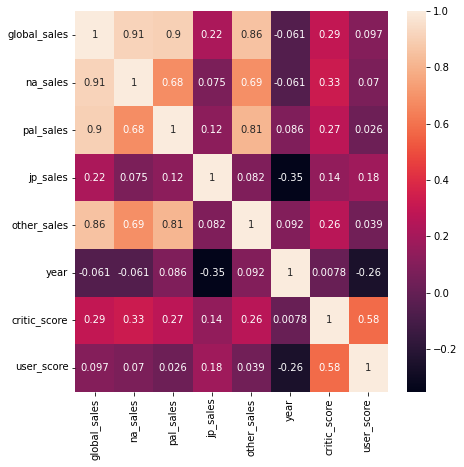

In [14]:
# look at correlation and plot heatmap
correlation = sales_joined.corr()
plt.figure(figsize=(7,7))
sns.heatmap(correlation, annot=True);

In [15]:
correlation["global_sales"].sort_values(ascending=False)

global_sales    1.000000
na_sales        0.914597
pal_sales       0.903237
other_sales     0.855722
critic_score    0.294597
jp_sales        0.221712
user_score      0.097225
year           -0.061268
Name: global_sales, dtype: float64

Strong correlation between na/pal sales and global sales, could potentially indicate that a game that performs well in North America or Europe is likely to perform well globally.

Also interesting to note that critic scores are more correlated to global sales than user scores are.

<Figure size 504x504 with 0 Axes>

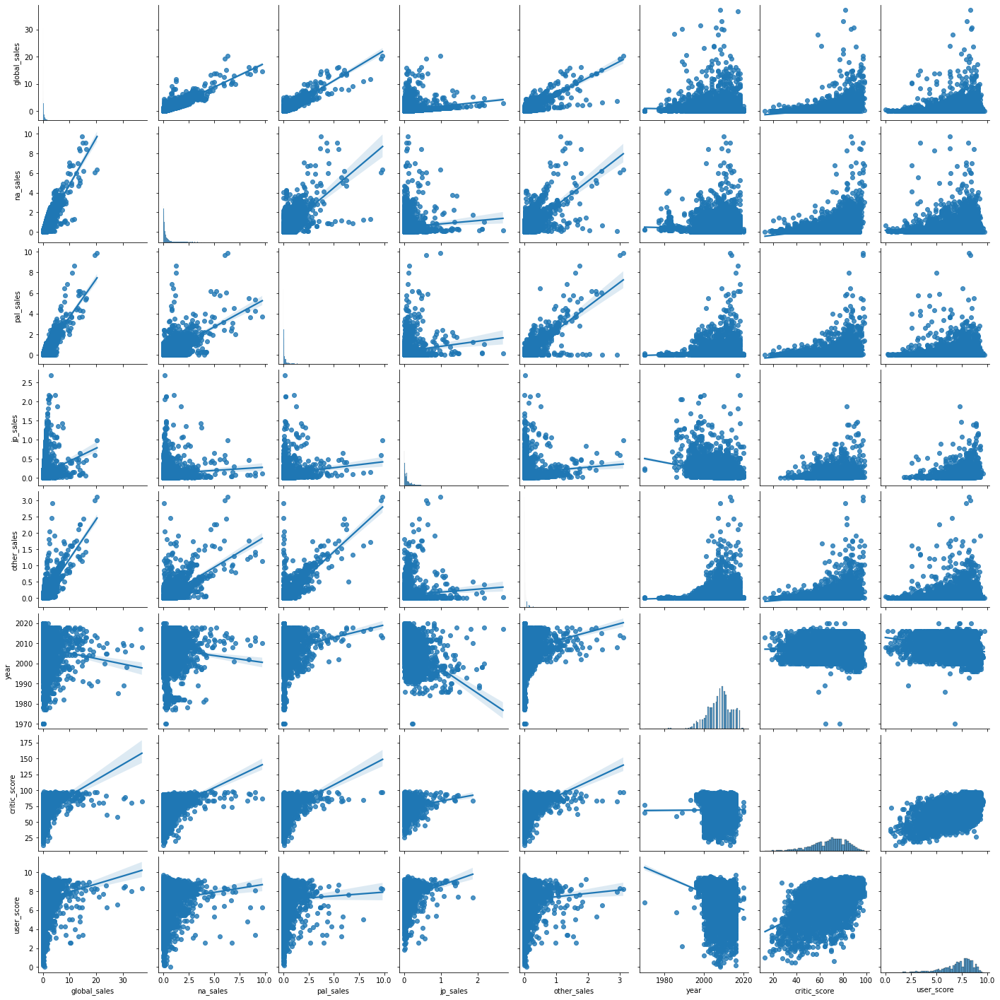

In [16]:
# variable distribution
plt.figure(figsize=(7,7))
sns.pairplot(sales_joined, kind="reg");

All sales columns appear to be heavily right skewed. Critic and user score looks better, but left skewed. Outliers to deal with in many columns.

In [17]:
# look at skewness per column
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', 'year', \
                           'critic_score', 'user_score']].columns.values.tolist():
    print(column)
    print(sales_joined[column].skew())
    print()

global_sales
10.556370934968717

na_sales
6.4345944256865355

pal_sales
8.786859123829345

jp_sales
4.56899575356718

other_sales
9.083983534764267

year
-0.8087338675309454

critic_score
-0.610669523803431

user_score
-1.2542147910079844



Most of the columns are heavily skewed, with a skewness magnitude higher than 1.

critic_score and year are moderately left skewed.

In [18]:
# look at distribution for each variable
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', 'year', \
                           'critic_score', 'user_score']]:
    fig=px.histogram(sales_joined, x=sales_joined[column])
    fig.show();

In [19]:
# boxplot distribution for each variable
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', 'year', \
                           'critic_score', 'user_score']]:
    fig=px.box(sales_joined, x=sales_joined[column])
    fig.show();

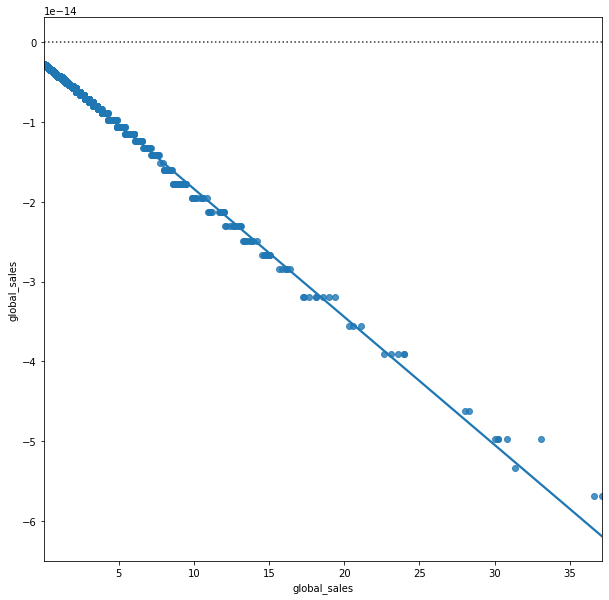

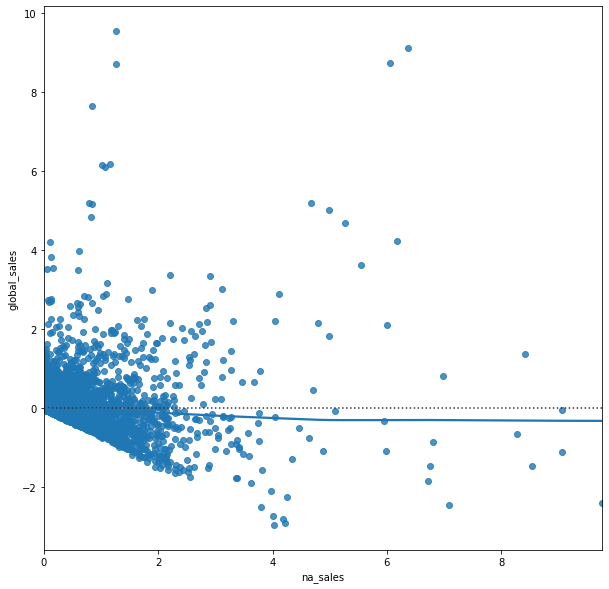

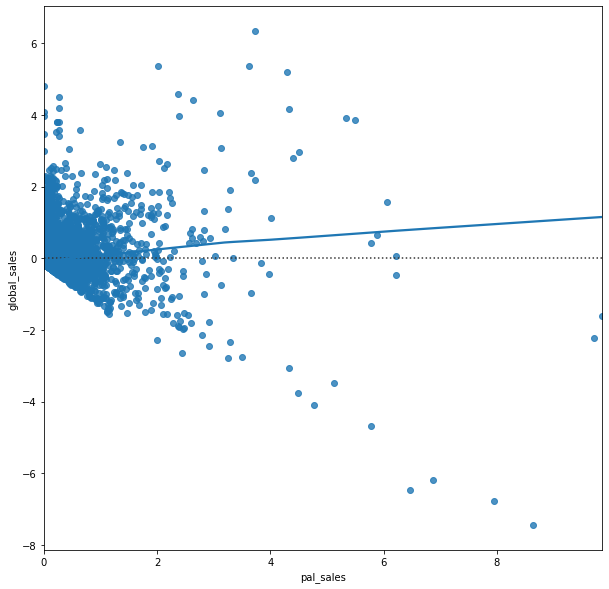

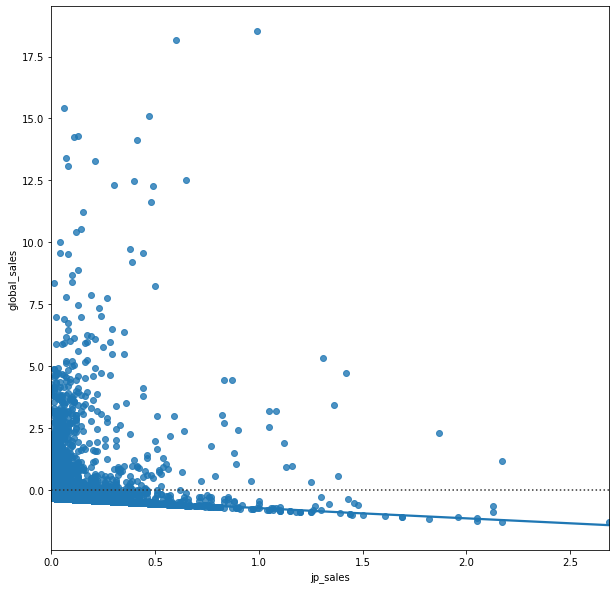

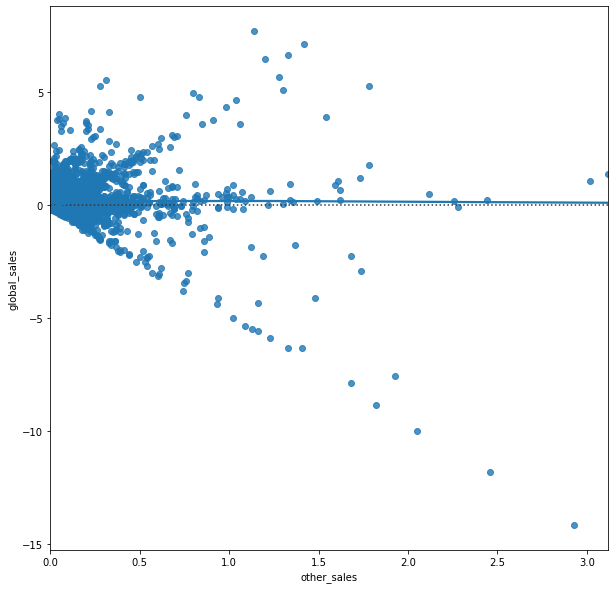

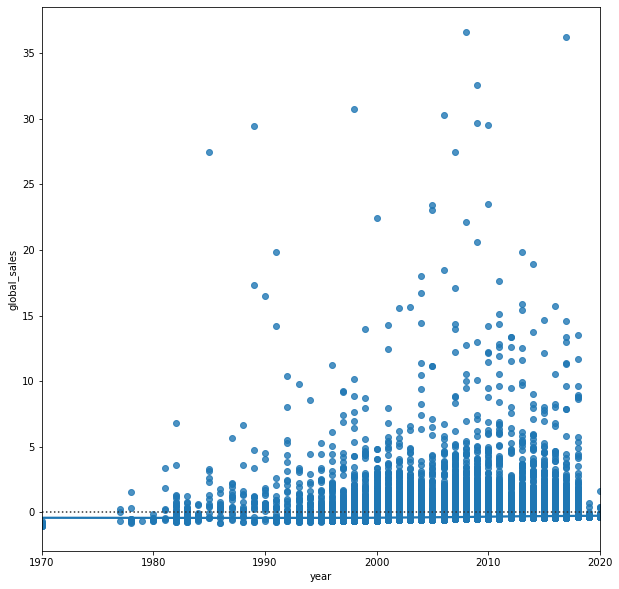

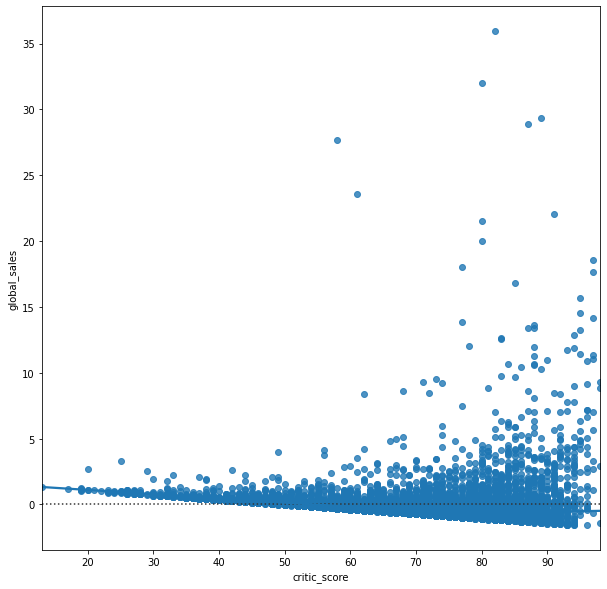

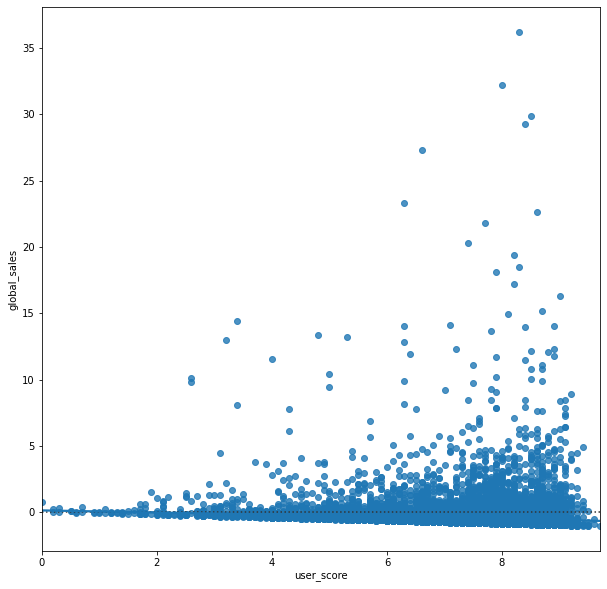

In [20]:
# look at residuals
for column in sales_joined[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', 'year', \
                           'critic_score', 'user_score']]:
    plt.figure(figsize=(10,10))
    sns.residplot(x=sales_joined[column], y=sales_joined["global_sales"], data=sales_joined, lowess=True)

## Cleaning

In [22]:
sales_joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19829 entries, 2 to 19833
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   genre         19829 non-null  object 
 1   esrb_rating   13920 non-null  object 
 2   platform      19829 non-null  object 
 3   publisher     19829 non-null  object 
 4   global_sales  19829 non-null  float64
 5   na_sales      12773 non-null  float64
 6   pal_sales     12121 non-null  float64
 7   jp_sales      6767 non-null   float64
 8   other_sales   14496 non-null  float64
 9   year          19829 non-null  int64  
 10  critic_score  7950 non-null   float64
 11  user_score    7382 non-null   float64
dtypes: float64(7), int64(1), object(4)
memory usage: 2.5+ MB


In [23]:
# replace NaNs with mean of each variable
sales_clean = sales_joined.copy()

mean_1 = sales_clean["na_sales"].mean(axis=0)
mean_2 = sales_clean["pal_sales"].mean(axis=0)
mean_3 = sales_clean["jp_sales"].mean(axis=0)
mean_4 = sales_clean["other_sales"].mean(axis=0)
mean_5 = sales_clean["critic_score"].mean(axis=0)
mean_6 = sales_clean["user_score"].mean(axis=0)

sales_clean["na_sales"].replace(np.nan, mean_1, inplace=True)
sales_clean["pal_sales"].replace(np.nan, mean_2, inplace=True)
sales_clean["jp_sales"].replace(np.nan, mean_3, inplace=True)
sales_clean["other_sales"].replace(np.nan, mean_4, inplace=True)
sales_clean["critic_score"].replace(np.nan, mean_5, inplace=True)
sales_clean["user_score"].replace(np.nan, mean_6, inplace=True)

In [24]:
sales_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19829 entries, 2 to 19833
Data columns (total 12 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   genre         19829 non-null  object 
 1   esrb_rating   13920 non-null  object 
 2   platform      19829 non-null  object 
 3   publisher     19829 non-null  object 
 4   global_sales  19829 non-null  float64
 5   na_sales      19829 non-null  float64
 6   pal_sales     19829 non-null  float64
 7   jp_sales      19829 non-null  float64
 8   other_sales   19829 non-null  float64
 9   year          19829 non-null  int64  
 10  critic_score  19829 non-null  float64
 11  user_score    19829 non-null  float64
dtypes: float64(7), int64(1), object(4)
memory usage: 2.5+ MB


In [25]:
# find and remove outliers
z = np.abs(stats.zscore(sales_clean[['global_sales', 'na_sales', 'pal_sales', 'jp_sales', 'other_sales', 'year', \
                           'critic_score', 'user_score']]))
filtered = (z<3).all(axis=1)
sales_3 = sales_clean[filtered]
sales_3.head()

,genre,esrb_rating,platform,publisher,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
278,Adventure,E,Nintendo DS,Nintendo,4.76,0.279823,0.168932,0.114518,0.047913,2007,90.000000,8.000000
282,MMO,T,PC,Blizzard Entertainment,4.70,0.279823,0.168932,0.114518,0.047913,2010,90.000000,5.600000
285,Racing,E,PlayStation Portable,Sony Computer Entertainment,4.67,0.279823,0.168932,0.114518,0.047913,2009,68.956352,7.133839
288,Action,M,PlayStation 2,Sony Computer Entertainment,4.62,0.279823,0.168932,0.114518,0.047913,2005,94.000000,8.900000
289,Adventure,NaN,SNES,Nintendo,4.61,0.279823,0.168932,0.114518,0.047913,1992,68.956352,7.133839


<Figure size 504x504 with 0 Axes>

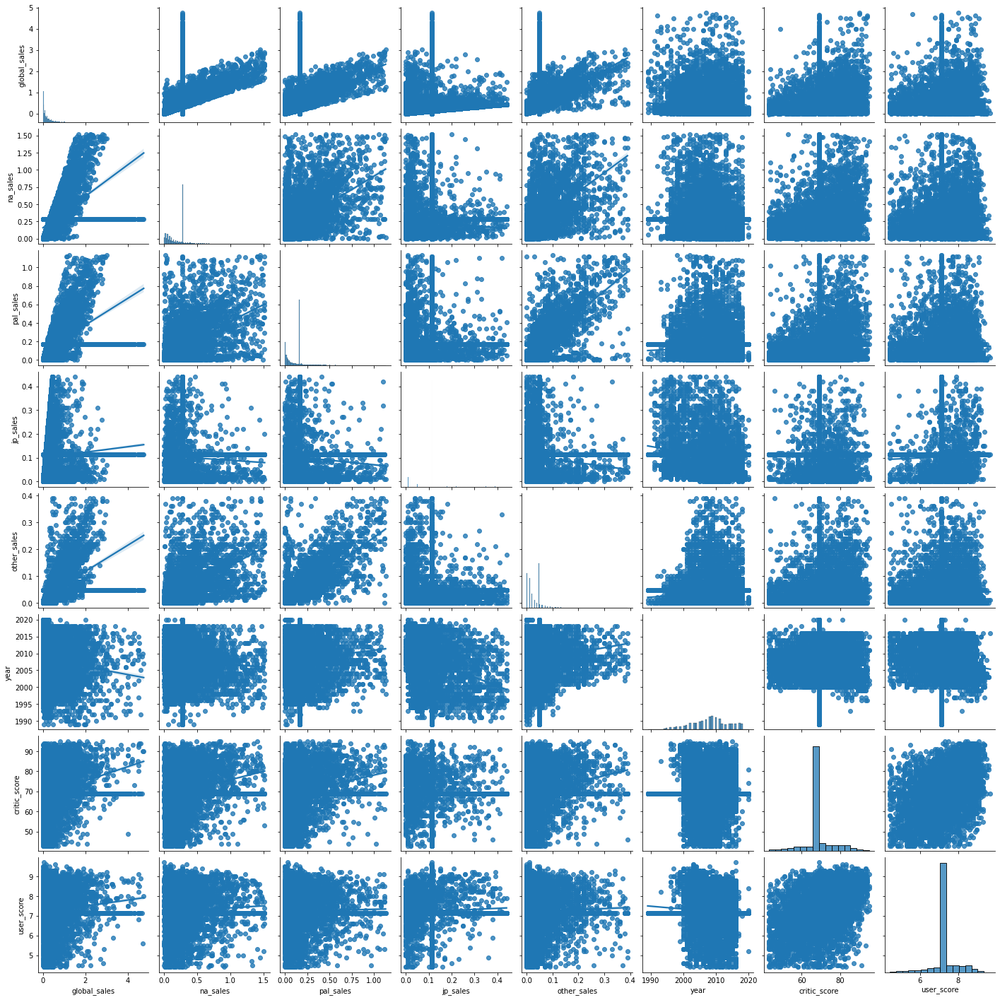

In [26]:
# look at skewness again
plt.figure(figsize=(7,7))
sns.pairplot(sales_3, kind="reg");

Not ideal but looks better.

## Model building

In [27]:
sales_3

,genre,esrb_rating,platform,publisher,global_sales,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score
278,Adventure,E,Nintendo DS,Nintendo,4.76,0.279823,0.168932,0.114518,0.047913,2007,90.000000,8.000000
282,MMO,T,PC,Blizzard Entertainment,4.70,0.279823,0.168932,0.114518,0.047913,2010,90.000000,5.600000
285,Racing,E,PlayStation Portable,Sony Computer Entertainment,4.67,0.279823,0.168932,0.114518,0.047913,2009,68.956352,7.133839
288,Action,M,PlayStation 2,Sony Computer Entertainment,4.62,0.279823,0.168932,0.114518,0.047913,2005,94.000000,8.900000
289,Adventure,NaN,SNES,Nintendo,4.61,0.279823,0.168932,0.114518,0.047913,1992,68.956352,7.133839
...,...,...,...,...,...,...,...,...,...,...,...,...
19829,Simulation,T,PC,GMX Media,0.01,0.279823,0.000000,0.114518,0.000000,2004,68.956352,7.133839
19830,Shooter,T,PC,Ubisoft,0.01,0.279823,0.000000,0.114518,0.000000,2003,68.956352,7.133839
19831,Fighting,NaN,PlayStation 2,Capcom,0.01,0.279823,0.168932,0.010000,0.047913,2002,68.956352,7.133839
19832,Adventure,NaN,PlayStation Vita,Rejet,0.01,0.279823,0.168932,0.010000,0.047913,2017,68.956352,7.133839


In [28]:
# create dummy variables
sales_3 = pd.get_dummies(sales_3, drop_first = True)

In [29]:
# set response array 
y = sales_3["global_sales"]

# put predictors in a data frame
X = sales_3.drop(columns = "global_sales")

In [30]:
# model
model_1 = sm.OLS(y, X).fit()
model_1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:           global_sales   R-squared (uncentered):                   0.744
Model:                            OLS   Adj. R-squared (uncentered):              0.730
Method:                 Least Squares   F-statistic:                              52.25
Date:                Thu, 02 Jun 2022   Prob (F-statistic):                        0.00
Time:                        15:20:16   Log-Likelihood:                         -4231.4
No. Observations:               18011   AIC:                                  1.036e+04
Df Residuals:                   17060   BIC:                                  1.778e+04
Df Model:                         951                                                  
Covariance Type:            nonrobust                                                  
====================================================================================================================
                                                       coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------
na_sales                                             0.8099      0.016     49.212      0.000       0.778       0.842
pal_sales                                            0.7575      0.028     27.015      0.000       0.703       0.812
jp_sales                                             0.7079      0.049     14.420      0.000       0.612       0.804
other_sales                                          2.5587      0.100     25.639      0.000       2.363       2.754
year                                                -0.0003      0.000     -2.323      0.020      -0.001   -4.69e-05
critic_score                                         0.0033      0.000      8.121      0.000       0.002       0.004
user_score                                           0.0227      0.004      5.373      0.000       0.014       0.031
genre_Action-Adventure                              -0.0222      0.020     -1.091      0.275      -0.062       0.018
genre_Adventure                                     -0.0421      0.011     -3.882      0.000      -0.063      -0.021
genre_Board Game                                     0.0845      0.225      0.376      0.707      -0.356       0.525
genre_Education                                     -0.3849      0.223     -1.728      0.084      -0.822       0.052
genre_Fighting                                       0.0159      0.014      1.176      0.240      -0.011       0.043
genre_MMO                                            0.1121      0.053      2.100      0.036       0.007       0.217
genre_Misc                                          -0.0376      0.010     -3.665      0.000      -0.058      -0.017
genre_Music                                         -0.0090      0.030     -0.304      0.761      -0.067       0.049
genre_Party                                          0.1227      0.057      2.148      0.032       0.011       0.235
genre_Platform                                       0.0745      0.013      5.878      0.000       0.050       0.099
genre_Puzzle                                        -0.0401      0.015     -2.629      0.009      -0.070      -0.010
genre_Racing                                         0.0165      0.012      1.381      0.167      -0.007       0.040
genre_Role-Playing                                   0.0140      0.011      1.262      0.207      -0.008       0.036
genre_Sandbox                                       -0.0483      0.149     -0.324      0.746      -0.340       0.244
genre_Shooter                                       -0.0277      0.012     -2.407      0.016      -0.050      -0.005
genre_Simulation                                    -0.0085

In [31]:
from sklearn.linear_model import LinearRegression

In [32]:
# define model and fit it using extracted data
model_2 = LinearRegression()

model_2.fit(X, y)

LinearRegression()

In [33]:
# check model's R-squared value
model_2.score(X, y)

0.6347754069650897

In [34]:
model_2.intercept_

11.337581996649952

In [35]:
model_2.coef_

array([ 8.06202757e-01,  7.59729817e-01,  7.01419102e-01,  2.56284944e+00,
       -5.91329671e-03,  3.30517728e-03,  2.11361624e-02, -1.92190840e-02,
       -4.23220507e-02,  8.47868769e-02, -3.89696283e-01,  1.56890009e-02,
        1.20689792e-01, -3.67393633e-02,  1.38861767e-03,  1.21763524e-01,
        7.29585040e-02, -4.29735250e-02,  1.35798701e-02,  1.41933482e-02,
       -4.52442382e-02, -3.02068154e-02, -9.88371621e-03, -1.88745087e-02,
       -7.65979951e-02, -4.25771731e-02,  7.76127430e-02, -1.20932270e-03,
        1.39152028e-01, -4.41141402e-02,  9.16888484e-02,  1.76382846e-01,
       -6.31446773e-03,  9.67073224e-01,  1.39585366e-02,  4.40567969e-01,
       -2.28922293e-01, -7.53367076e-03,  9.53930353e-02, -1.34195213e-02,
       -2.38800370e-02,  3.40600845e-02, -3.03157392e-02, -3.84301901e-03,
        2.50184526e-02, -3.80596358e-02, -3.46304870e-02, -1.84930680e-02,
       -8.16704639e-02, -7.37389239e-02, -7.95828614e-02,  7.47841955e-02,
       -2.73062681e-01, -

In [36]:
pd.DataFrame(
  {
  "Variable" : X.columns.values,
  "Coefficient" : model_2.coef_
  }
)

,Variable,Coefficient
0,na_sales,0.806203
1,pal_sales,0.759730
2,jp_sales,0.701419
3,other_sales,2.562849
4,year,-0.005913
...,...,...
946,publisher_imageepoch Inc.,-0.233382
947,publisher_inXile Entertainment,-0.061580
948,publisher_indiePub,-0.185195
949,"publisher_mixi, Inc",0.649496


In [37]:
# add in the constant to the data
X = sm.add_constant(X)
X.head()

/usr/local/anaconda3/lib/python3.9/site-packages/statsmodels/tsa/tsatools.py:142: FutureWarning:

In a future version of pandas all arguments of concat except for the argument 'objs' will be keyword-only.



,const,na_sales,pal_sales,jp_sales,other_sales,year,critic_score,user_score,genre_Action-Adventure,genre_Adventure,...,publisher_fonfun,publisher_honeybee,publisher_iMel,publisher_iWin,publisher_id Software,publisher_imageepoch Inc.,publisher_inXile Entertainment,publisher_indiePub,"publisher_mixi, Inc",publisher_responDESIGN
278,1.0,0.279823,0.168932,0.114518,0.047913,2007,90.000000,8.000000,0,1,...,0,0,0,0,0,0,0,0,0,0
282,1.0,0.279823,0.168932,0.114518,0.047913,2010,90.000000,5.600000,0,0,...,0,0,0,0,0,0,0,0,0,0
285,1.0,0.279823,0.168932,0.114518,0.047913,2009,68.956352,7.133839,0,0,...,0,0,0,0,0,0,0,0,0,0
288,1.0,0.279823,0.168932,0.114518,0.047913,2005,94.000000,8.900000,0,0,...,0,0,0,0,0,0,0,0,0,0
289,1.0,0.279823,0.168932,0.114518,0.047913,1992,68.956352,7.133839,0,1,...,0,0,0,0,0,0,0,0,0,0


In [39]:
sm_model = sm.OLS(y, X).fit()
sm_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           global_sales   R-squared:                       0.635
Model:                            OLS   Adj. R-squared:                  0.614
Method:                 Least Squares   F-statistic:                     31.18
Date:                Thu, 02 Jun 2022   Prob (F-statistic):               0.00
Time:                        15:21:21   Log-Likelihood:                -4216.4
No. Observations:               18011   AIC:                         1.034e+04
Df Residuals:                   17059   BIC:                         1.776e+04
Df Model:                         951                                         
Covariance Type:            nonrobust                                         
====================================================================================================================
                                                       coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------
const                                               11.3376      2.124      5.338      0.000       7.175      15.501
na_sales                                             0.8062      0.016     48.980      0.000       0.774       0.838
pal_sales                                            0.7597      0.028     27.114      0.000       0.705       0.815
jp_sales                                             0.7014      0.049     14.294      0.000       0.605       0.798
other_sales                                          2.5628      0.100     25.701      0.000       2.367       2.758
year                                                -0.0059      0.001     -5.582      0.000      -0.008      -0.004
critic_score                                         0.0033      0.000      8.182      0.000       0.003       0.004
user_score                                           0.0211      0.004      5.001      0.000       0.013       0.029
genre_Action-Adventure                              -0.0192      0.020     -0.945      0.345      -0.059       0.021
genre_Adventure                                     -0.0423      0.011     -3.906      0.000      -0.064      -0.021
genre_Board Game                                     0.0848      0.225      0.377      0.706      -0.355       0.525
genre_Education                                     -0.3897      0.223     -1.751      0.080      -0.826       0.047
genre_Fighting                                       0.0157      0.014      1.158      0.247      -0.011       0.042
genre_MMO                                            0.1207      0.053      2.262      0.024       0.016       0.225
genre_Misc                                          -0.0367      0.010     -3.585      0.000      -0.057      -0.017
genre_Music                                          0.0014      0.030      0.047      0.963      -0.057       0.060
genre_Party                                          0.1218      0.057      2.133      0.033       0.010       0.234
genre_Platform                                       0.0730      0.013      5.760      0.000       0.048       0.098
genre_Puzzle                                        -0.0430      0.015     -2.821      0.005      -0.073      -0.013
genre_Racing                                         0.0136      0.012      1.138      0.255      -0.010       0.037
genre_Role-Playing                                   0.0142      0.011      1.283      0.200      -0.007       0.036
genre_Sandbox                                       -0.0452      0.149     -0.304      0.761      -0.337       0.246
genre_Shooter                                       -0.0302      0.012     -2.624      0.009      -0.053      -0.008
genre_Simulation                         